In [7]:
from sklearn.datasets import fetch_openml
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



mnist = fetch_openml('mnist_784', parser='auto')

Xall, yall = mnist.data, mnist.target.astype(int)
Xall = Xall / 255.0 # Scale the pixel values to [0, 1]

# Perform PCA on the data
pca = PCA(n_components=3)
X_pca = pca.fit_transform(Xall)


X_pca=np.array(X_pca)
yall=np.array(yall)

print(Xall.shape)
print(X_pca.shape)

X = X_pca[:300,:]
y = yall[:300]




(70000, 784)
(70000, 3)


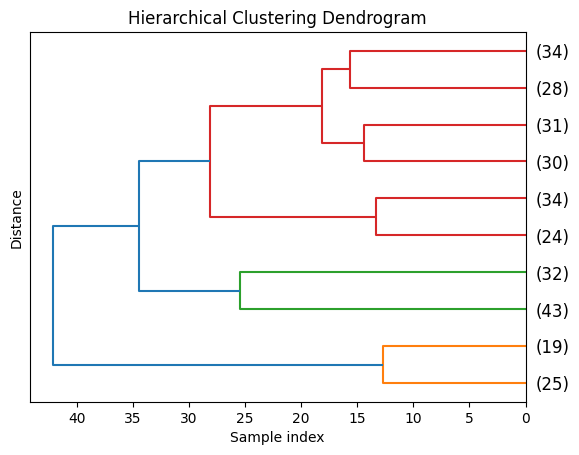

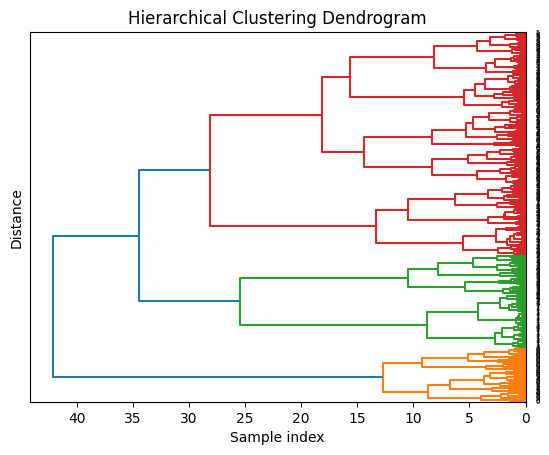

In [13]:
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree

Z = linkage(X, 'ward')

# Plot the dendrogram
#plt.figure(figsize=(12, 8))

dendrogram(Z, labels=y, orientation='left', truncate_mode='lastp', p=10)
#dendrogram(Z, labels=y, orientation='left', truncate_mode='lastp', p=10, leaf_rotation=90)
#cluster_assignments = cut_tree(Z, n_clusters=10)

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.savefig('dendro1.eps', format='eps', bbox_inches='tight')
plt.show()

dendrogram(Z, labels=y, orientation='left')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.savefig('dendro2.eps', format='eps', bbox_inches='tight')
plt.show()


/Users/nathankutz/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


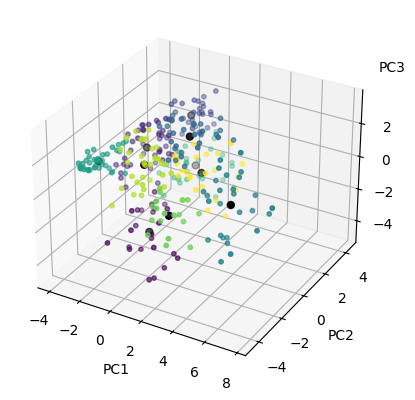

In [14]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=10)
kmeans.fit(X)
labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_

#print(X.shape)
#print(labels.shape)

fig = plt.figure()
#plt.figure(figsize=(40, 40))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=labels.astype(int), s=10)
ax.scatter(cluster_centers[:,0], cluster_centers[:,1], cluster_centers[:,2], color='black', marker='.', s=100)
#ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2], c=mnist.target.astype(int), s=20)

# Set the labels and limits of the plot
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
fig.text(0.80, 0.75, 'PC3')

plt.savefig('kmeans.eps', format='eps', bbox_inches='tight')
#ax.view_init(elev=20, azim=60)

plt.show()




In [16]:
from sklearn.mixture import GaussianMixture

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


gmm = GaussianMixture(n_components=10, covariance_type='diag', random_state=42)
gmm.fit(X_train)

# Predict the classes for the test data
y_pred = gmm.predict(X_test)

# Compute the accuracy score
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

means = gmm.means_
variances = gmm.covariances_

print(means.shape)

# Print the results
print("Gaussian Centers:")
for i, mean in enumerate(means):
    print(f"Component {i}: {mean}")

print("\nGaussian Variances:")
for i, variance in enumerate(variances):
    print(f"Component {i}: {variance}")
    
    
    

Accuracy: 0.03
(10, 3)
Gaussian Centers:
Component 0: [ 1.05111397 -2.72589063 -4.48085654]
Component 1: [-0.91827887  1.45451314  1.86411567]
Component 2: [-1.9759309   1.71669012 -0.33456835]
Component 3: [ 4.5917655  -1.19348435 -0.16413765]
Component 4: [-3.15460143 -1.32289835  0.51057489]
Component 5: [1.52246101 0.0234955  2.44238197]
Component 6: [-0.14441277 -1.20497443  0.51087579]
Component 7: [ 1.73108521 -0.75284258 -0.65858368]
Component 8: [-0.30312166  2.97792755 -0.82113925]
Component 9: [-1.03157768 -0.74874499 -2.98255338]

Gaussian Variances:
Component 0: [0.02493351 0.17565531 0.04771204]
Component 1: [0.55801517 2.10779963 0.23496505]
Component 2: [0.2328301  0.41236415 0.76200738]
Component 3: [1.71098313 0.66776242 2.82484358]
Component 4: [0.28766093 0.88161952 0.52445649]
Component 5: [0.42510788 0.85248551 0.22021842]
Component 6: [0.7456143  1.44740512 1.4318058 ]
Component 7: [0.80959895 3.97624877 1.62483709]
Component 8: [0.66189428 0.64489126 1.45590474]

In [19]:

import plotly.graph_objects as go
from scipy.stats import multivariate_normal

# Define the Gaussian center and variances
xp, yp, zp = means[0]
vx, vy, vz = variances[0]

# Create a meshgrid of points to evaluate the Gaussian
X, Y, Z = np.meshgrid(np.linspace(- 6, 6, 50),
                     np.linspace(- 6, 6, 50),
                     np.linspace(- 6,  6, 50))

# Evaluate the Gaussian function
gaussian_3d = multivariate_normal.pdf(np.stack([X.ravel(), Y.ravel(), Z.ravel()], axis=-1), mean=[xp, yp, zp], cov=[[vx, 0, 0], [0, vy, 0], [0, 0, vz]])
gaussian_3d = gaussian_3d.reshape(X.shape)

xp, yp, zp = means[2]
vx, vy, vz = variances[2]

gaussian_3d2 = multivariate_normal.pdf(np.stack([X.ravel(), Y.ravel(), Z.ravel()], axis=-1), mean=[xp, yp, zp], cov=[[vx, 0, 0], [0, vy, 0], [0, 0, vz]])
gaussian_3d2 = gaussian_3d.reshape(X.shape)

#gauss = gaussian_3d + gaussian_3d2
#gauss = gaussian_3d2
gauss = gaussian_3d 

fig = go.Figure(data=go.Isosurface(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=gauss.flatten(),
    isomin=0.01,
    isomax=10,
    surface_count=4, # number of isosurfaces, 2 by default: only min and max
    colorbar_nticks=5, # colorbar ticks correspond to isosurface values
    caps=dict(x_show=False, y_show=False)
    ))
fig.show()
